In [ ]:
!pip install ultralytics

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()


Ultralytics YOLOv8.0.209 🚀 Python-3.10.12 torch-2.1.0+cu118 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 26.8/107.7 GB disk)


In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

from IPython import display
display.clear_output()

import detectron2
print("detectron2:", detectron2.__version__)

detectron2: 0.6


In [ ]:
!pip install supervision==0.2.0



In [ ]:
from IPython import display
display.clear_output()

import supervision as sv
print("supervision", sv.__version__)

supervision 0.2.0


In [ ]:


SOURCE_VIDEO_PATH = f"/content/drive/MyDrive/IMG_2665.MOV"

In [ ]:
MODEL = "/content/drive/MyDrive/yolov8_chicken/best.pt"
from ultralytics import YOLO

model = YOLO(MODEL)
model.fuse()

Model summary (fused): 168 layers, 3006428 parameters, 0 gradients, 8.1 GFLOPs



0: 1280x736 76 0s, 40 2s, 1 3, 445.2ms
Speed: 24.9ms preprocess, 445.2ms inference, 1.1ms postprocess per image at shape (1, 3, 1280, 736)


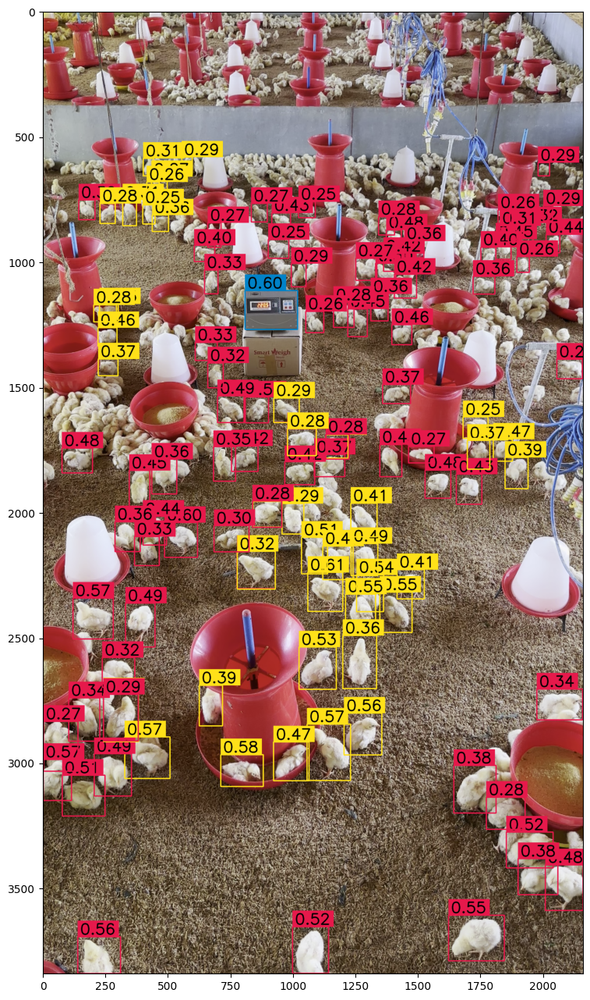

In [ ]:
import supervision as sv

# extract video frame
generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_yolov8(results)

# annotate
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
frame = box_annotator.annotate(scene=frame, detections=detections)

%matplotlib inline
sv.show_frame_in_notebook(frame, (16, 16))


0: 1280x736 76 0s, 40 2s, 1 3, 12.2ms
Speed: 9.3ms preprocess, 12.2ms inference, 1.6ms postprocess per image at shape (1, 3, 1280, 736)


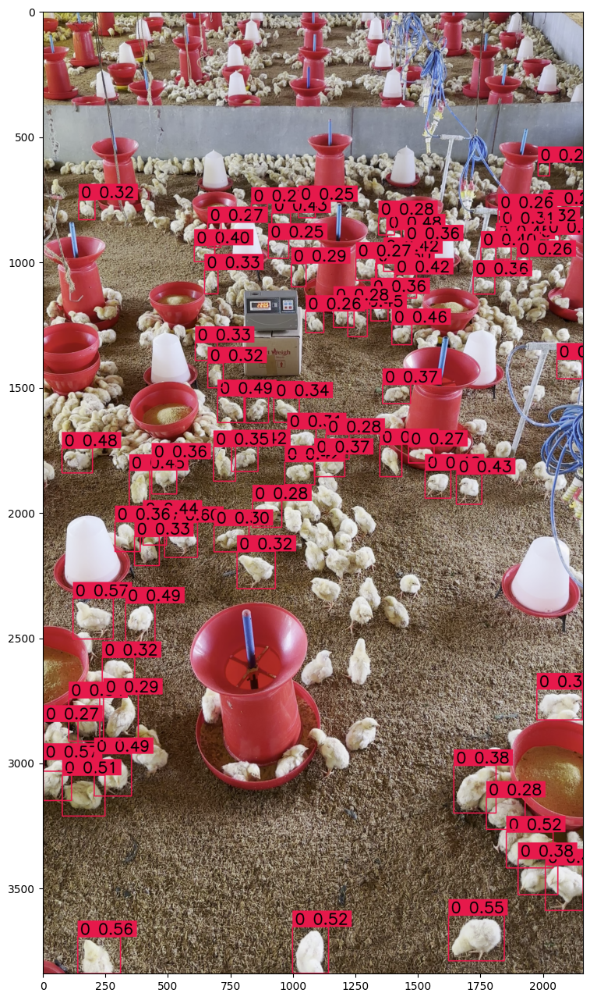

In [ ]:
import supervision as sv

# extract video frame
generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_yolov8(results)
detections = detections[detections.class_id == 0]

# annotate
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, confidence, class_id, _ in detections]
frame = box_annotator.annotate(scene=frame, detections=detections, labels=labels)

%matplotlib inline
sv.show_frame_in_notebook(frame, (16, 16))


0: 1280x736 76 0s, 40 2s, 1 3, 397.2ms
Speed: 11.4ms preprocess, 397.2ms inference, 1.3ms postprocess per image at shape (1, 3, 1280, 736)


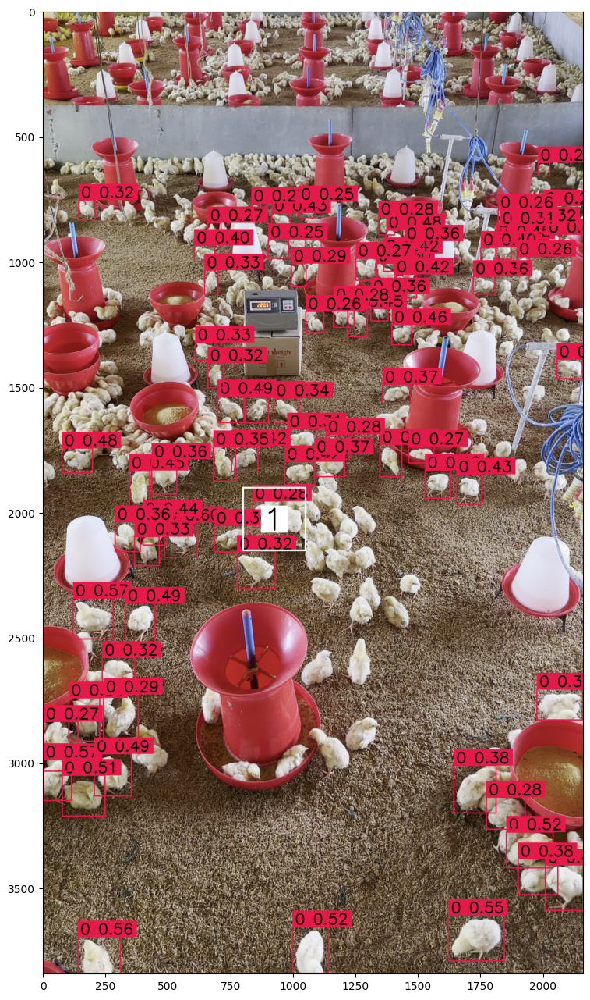

In [ ]:
import numpy as np
import supervision as sv

# initiate polygon zone
polygon = np.array([
    [800, 1900],
    [1050, 1900],
    [1050, 2150],
    [800, 2150]
])
video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)
zone = sv.PolygonZone(polygon=polygon, frame_resolution_wh=video_info.resolution_wh)

# initiate annotators
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.white(), thickness=6, text_thickness=6, text_scale=4)

# extract video frame
generator = sv.get_video_frames_generator(SOURCE_VIDEO_PATH)
iterator = iter(generator)
frame = next(iterator)

# detect
results = model(frame, imgsz=1280)[0]
detections = sv.Detections.from_yolov8(results)
detections = detections[detections.class_id == 0]
zone.trigger(detections=detections)

# annotate
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, confidence, class_id, _ in detections]
frame = box_annotator.annotate(scene=frame, detections=detections, labels=labels)
frame = zone_annotator.annotate(scene=frame)

%matplotlib inline
sv.show_frame_in_notebook(frame, (16, 16))

In [ ]:
import numpy as np
import supervision as sv

# initiate polygon zone
polygon = np.array([
    [800, 1800],
    [1050, 1800],
    [1050, 2050],
    [800, 2050]
])
video_info = sv.VideoInfo.from_video_path(SOURCE_VIDEO_PATH)
zone = sv.PolygonZone(polygon=polygon, frame_resolution_wh=video_info.resolution_wh)

# initiate annotators
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
zone_annotator = sv.PolygonZoneAnnotator(zone=zone, color=sv.Color.white(), thickness=6, text_thickness=6, text_scale=4)

def process_frame(frame: np.ndarray, _) -> np.ndarray:
    # detect
    results = model(frame, imgsz=1280)[0]
    detections = sv.Detections.from_yolov8(results)
    detections = detections[detections.class_id == 0]
    zone.trigger(detections=detections)

    # annotate
    box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)
    labels = [f"{model.names[class_id]} {confidence:0.2f}" for _, confidence, class_id, _ in detections]
    frame = box_annotator.annotate(scene=frame, detections=detectionsc)
    frame = zone_annotator.annotate(scene=frame)

    return frame

sv.process_video(source_path=SOURCE_VIDEO_PATH, target_path=f"/content/drive/MyDrive/yolov8_chicken/weight-result.mp4", callback=process_frame)

from IPython import display
display.clear_output()

In [ ]:
import cv2
import pytesseract
import numpy as np
import supervision as sv

# initiate annotators
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)

def extract_weight(roi):
    print("Extract Weight Function Called")

    # Convert the ROI to grayscale
    gray_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)

    # Resize the image before thresholding
    resized_roi = cv2.resize(gray_roi, (640, 380))  # Specify new_width and new_height

    # Apply denoising
    denoised_roi = cv2.fastNlMeansDenoising(resized_roi, None, h=10, searchWindowSize=21)  # Adjust parameters as needed

    # Apply smoothing
    smoothed_roi = cv2.GaussianBlur(denoised_roi, (5, 5), 0)  # Adjust kernel size as needed

    # Apply a threshold to extract the digits
    _, thresh = cv2.threshold(smoothed_roi, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    # Print thresholded image for debugging
    cv2.imshow("Thresholded Image", thresh)
    cv2.waitKey(0)
    cv2.destroyAllWindows()

    # Use pytesseract to recognize the digits
    weight_text = pytesseract.image_to_string(thresh, config='--psm 8 --oem 3 -c tessedit_char_whitelist=0123456789')

    print("OCR Output:", weight_text)

    try:
        weight = float(weight_text)
        return weight
    except ValueError:
        print("Error converting text to float:", weight_text)
        return None


# Open the video file
cap = cv2.VideoCapture('/content/drive/MyDrive/IMG_2665.MOV')  # Replace with your video file path

# Get video information (e.g., frame width, height, frames per second)
fps = cap.get(cv2.CAP_PROP_FPS)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

# Create an output video file
out = cv2.VideoWriter('/content/drive/MyDrive/output_video.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

while True:
    # Read a frame from the video
    ret, frame = cap.read()

    # Break the loop if we have reached the end of the video
    if not ret:
        break

    # detect
    results = model(frame, imgsz=1280)[0]
    detections = sv.Detections.from_yolov8(results)
    # Filter detections for class ID 3
    weight_detections = detections[detections.class_id == 3]

    # Iterate through weight detections
    # Iterate through weight detections
    for _, confidence, class_id, bbox in weight_detections:
    # Check if bbox is not None
      if bbox is not None:
        # Extract the region containing the object
        x, y, w, h = map(int, bbox)
        roi = frame[y:y+h, x:x+w]

        # Process the frame to extract the weight
        weight_value = extract_weight(roi)

        # Do something with the extracted weight value
        if weight_value is not None:
            print("Extracted Weight:", weight_value)

        # You can also annotate the frame with the weight value if needed
        cv2.putText(frame, f'Weight: {weight_value}', (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Write the frame to the output video
    out.write(frame)

# Release the video capture and output writer objects
cap.release()
out.release()

# Close any OpenCV windows
cv2.destroyAllWindows()



Streaming output truncated to the last 5000 lines.
0: 1280x736 97 0s, 63 2s, 1 3, 387.9ms
Speed: 11.6ms preprocess, 387.9ms inference, 1.4ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 83 0s, 65 2s, 1 3, 385.5ms
Speed: 7.2ms preprocess, 385.5ms inference, 1.5ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 83 0s, 63 2s, 1 3, 326.3ms
Speed: 17.1ms preprocess, 326.3ms inference, 1.0ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 86 0s, 64 2s, 1 3, 294.4ms
Speed: 12.0ms preprocess, 294.4ms inference, 1.1ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 90 0s, 63 2s, 1 3, 297.5ms
Speed: 6.6ms preprocess, 297.5ms inference, 1.0ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 70 0s, 77 2s, 1 3, 295.1ms
Speed: 8.1ms preprocess, 295.1ms inference, 1.0ms postprocess per image at shape (1, 3, 1280, 736)

0: 1280x736 61 0s, 92 2s, 1 3, 323.8ms
Speed: 10.3ms preprocess, 323.8ms inference, 1.0ms postprocess per image 

In [ ]:
!apt-get install tesseract-ocr
!apt-get install libtesseract-dev
!pip install pytesseract

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 8 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 2s (2,009 kB/s)
Selecting previously unselected package tesseract-ocr-eng.
(Reading database ... 120880 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-e


0: 1280x736 76 0s, 40 2s, 1 3, 12.3ms
Speed: 10.9ms preprocess, 12.3ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 736)


Number of weight detections: 1
Detection 1 - Class ID: 3, Confidence: 0.5952476859092712, Bounding Box: [     808.39      1113.9      1018.5      1268.5]
Bounding Box Coordinates: x=808, y=1113, w=1018, h=1268
ROI Shape: (100, 150, 3)
Extract Weight Function Called
ROI Shape: (100, 150, 3)


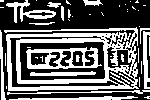

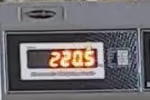

OCR Output: 21

Weight Value: 21.0
Extracted Weight: 21.0


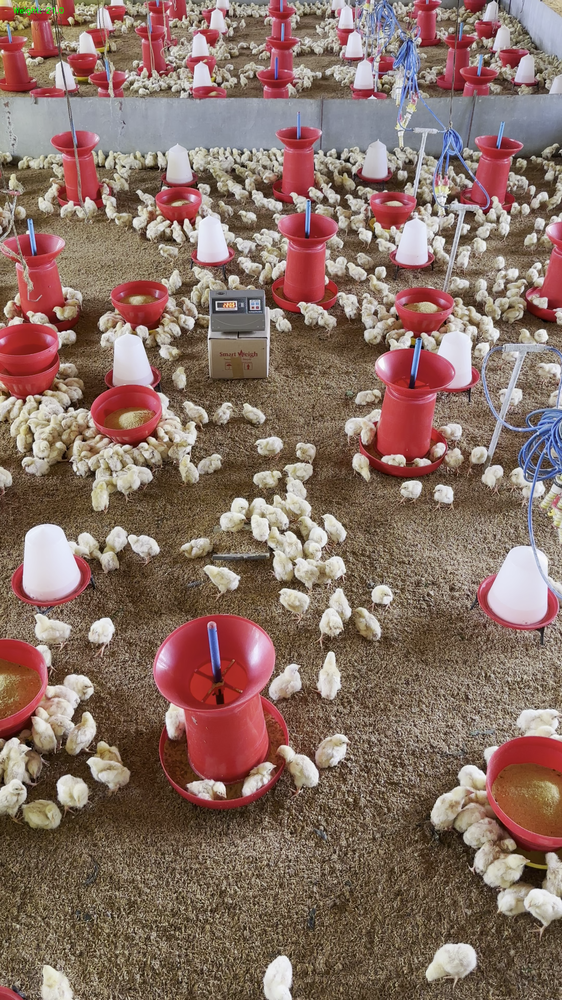

In [ ]:
import cv2
import pytesseract
import numpy as np
import supervision as sv
from google.colab.patches import cv2_imshow

# initiate annotators
box_annotator = sv.BoxAnnotator(thickness=4, text_thickness=4, text_scale=2)

def extract_weight(roi):
    print("Extract Weight Function Called")
    # Check the shape of the ROI
    print("ROI Shape:", roi.shape)
    # Convert the ROI to grayscale
    gray_roi = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)

    # Apply denoising
    denoised_roi = cv2.fastNlMeansDenoising(gray_roi, None, h=10, searchWindowSize=21)  # Adjust parameters as needed

    # Apply smoothing
    smoothed_roi = cv2.GaussianBlur(denoised_roi, (5, 5), 0)  # Adjust kernel size as needed

    # Apply a threshold to extract the digits
    # Experiment with different values for block_size and constant
    thresh = cv2.adaptiveThreshold(denoised_roi, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY_INV, 9, 1)


    # Print thresholded image for debugging
    cv2_imshow(thresh)
    # Print thresholded image for debugging
    cv2_imshow(roi)
    # Use pytesseract to recognize the digits
    weight_text = pytesseract.image_to_string(thresh, config='--psm 6 --oem 1 -c tessedit_char_whitelist=0123456789')

    print("OCR Output:", weight_text)

    try:
        weight = float(weight_text)
        return weight
    except ValueError:
        print("Error converting text to float:", weight_text)
        return None


# Open the video file
cap = cv2.VideoCapture('/content/drive/MyDrive/IMG_2665.MOV')  # Replace with your video file path
# Open the video file
ret, frame = cap.read()

# Check if the frame is successfully read
if not ret:
    print("Error reading frame.")
else:
    # Get video information (e.g., frame width, height)
    height, width = frame.shape[:2]

    # detect
    results = model(frame, imgsz=1280)[0]
    detections = sv.Detections.from_yolov8(results)
    # Filter detections for class ID 3
    weight_detections = detections[detections.class_id == 3]
    # Debug print to check the number of weight detections
    print("Number of weight detections:", len(weight_detections))

    # Iterate through weight detections
    for idx, detection in enumerate(weight_detections):
        bbox, confidence, class_id, _ = detection
        print(f"Detection {idx + 1} - Class ID: {class_id}, Confidence: {confidence}, Bounding Box: {bbox}")

        # Extract the bounding box coordinates
        x, y, w, h = map(int, bbox)
        print(f"Bounding Box Coordinates: x={x}, y={y}, w={w}, h={h}")
         # Dynamically adjust the ROI around the detected bounding box

        roi = frame[y:y+100, x:x+150]
        # Debug print to check if the roi is extracted
        print("ROI Shape:", roi.shape)


        # Process the frame to extract the weight
        weight_value = extract_weight(roi)
        # Debug print to check if the weight extraction function is called
        print("Weight Value:", weight_value)

        # Do something with the extracted weight value
        if weight_value is not None:
            print("Extracted Weight:", weight_value)

            # Annotate the frame with the weight value
            cv2.putText(frame, f'Weight: {weight_value}', (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Display the frame with annotations
    from PIL import Image
    from IPython.display import display

    # Convert the OpenCV image to a PIL image
    frame_pil = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

    # Display the PIL image
    display(frame_pil)

# Release the video capture object
cap.release()
